In [1]:
import polars as pl
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import gc

In [2]:
BASE_PATH = Path('/kaggle/input/jane-street-real-time-market-data-forecasting/train.parquet')
RESPONDER_COLS = [f'responder_{i}' for i in range(9)]

train_ds = pl.concat([
    pl.scan_parquet(BASE_PATH / f'partition_id={i}' / 'part-0.parquet')
    for i in range(10)
])

responders = train_ds.select(['date_id', 'time_id', 'symbol_id'] + RESPONDER_COLS).collect()
responders.head()

date_id,time_id,symbol_id,responder_0,responder_1,responder_2,responder_3,responder_4,responder_5,responder_6,responder_7,responder_8
i16,i16,i8,f32,f32,f32,f32,f32,f32,f32,f32,f32
0,0,1,0.738489,-0.069556,1.380875,2.005353,0.186018,1.218368,0.775981,0.346999,0.095504
0,0,7,2.965889,1.190077,-0.523998,3.849921,2.626981,5.0,0.703665,0.216683,0.778639
0,0,9,-0.864488,-0.280303,-0.326697,0.375781,1.271291,0.099793,2.109352,0.670881,0.772828
0,0,10,0.408499,0.223992,2.294888,1.097444,1.225872,1.225376,1.114137,0.775199,-1.379516
0,0,14,-0.373387,-0.502764,-0.348021,-3.928148,-1.591366,-5.0,-3.57282,-1.089123,-5.0


In [3]:
responders_pivot = responders.pivot(index=['date_id', 'time_id'], values=RESPONDER_COLS, 
                                    separator='_', on='symbol_id').fill_null(0)

responders_pivot.head()

date_id,time_id,responder_0_1,responder_0_7,responder_0_9,responder_0_10,responder_0_14,responder_0_16,responder_0_19,responder_0_33,responder_0_0,responder_0_2,responder_0_13,responder_0_15,responder_0_38,responder_0_3,responder_0_12,responder_0_8,responder_0_17,responder_0_34,responder_0_11,responder_0_30,responder_0_5,responder_0_20,responder_0_21,responder_0_22,responder_0_25,responder_0_26,responder_0_29,responder_0_36,responder_0_23,responder_0_27,responder_0_28,responder_0_35,responder_0_37,responder_0_4,responder_0_24,…,responder_8_9,responder_8_10,responder_8_14,responder_8_16,responder_8_19,responder_8_33,responder_8_0,responder_8_2,responder_8_13,responder_8_15,responder_8_38,responder_8_3,responder_8_12,responder_8_8,responder_8_17,responder_8_34,responder_8_11,responder_8_30,responder_8_5,responder_8_20,responder_8_21,responder_8_22,responder_8_25,responder_8_26,responder_8_29,responder_8_36,responder_8_23,responder_8_27,responder_8_28,responder_8_35,responder_8_37,responder_8_4,responder_8_24,responder_8_31,responder_8_6,responder_8_18,responder_8_32
i16,i16,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,…,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32
0,0,0.738489,2.965889,-0.864488,0.408499,-0.373387,0.505199,0.096462,0.209253,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,0.772828,-1.379516,-5.0,-0.101013,0.184303,0.280629,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,1,0.80866,3.119074,-0.962893,0.249527,-0.225428,-0.499438,0.052181,0.214374,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,0.898612,3.902426,-4.121665,0.263108,0.039609,0.181041,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,2,1.008327,4.780859,-0.891955,-1.273521,-0.217807,0.953355,0.063074,0.182786,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,0.723078,0.799255,-5.0,0.339472,0.311067,0.53101,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,3,0.848002,4.239198,-0.644806,-0.991729,-0.307403,1.078218,0.036324,0.259406,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,1.342801,-0.281881,-4.052035,0.305233,0.571973,0.295483,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,4,1.151784,4.538052,3.144852,-5.0,0.965314,-4.234819,-4.571598,-1.402216,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,0.37334,0.119153,-3.656975,-0.313954,0.241637,-0.288988,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [4]:
correlations_per_responder = {}
for responder_col in RESPONDER_COLS:
    columns = [f'{responder_col}_{i}' for i in range(39)]
    correlations = responders_pivot[columns].corr().to_pandas()
    correlations.index = list(range(39))
    correlations.columns = list(range(39))
    correlations_per_responder[responder_col] = correlations

In [5]:
fig, axes = plt.subplots(3, 3, figsize=(110, 100))
axes = axes.flatten()

for i, responder_col in enumerate(RESPONDER_COLS):
    sns.heatmap(correlations_per_responder[responder_col], cmap='viridis', annot=True, ax=axes[i])
    axes[i].set_title(responder_col)
plt.show()

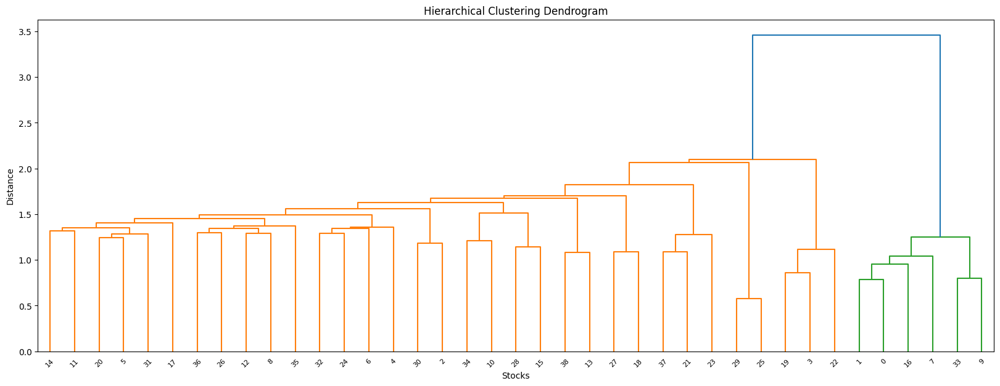

In [6]:
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

linked = linkage(correlations_per_responder['responder_6'], method='ward')

plt.figure(figsize=(20, 7))
dendrogram(linked, orientation='top', labels=correlations_per_responder['responder_6'].index, distance_sort='descending', color_threshold=2.5)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Stocks')
plt.ylabel('Distance')
plt.show()

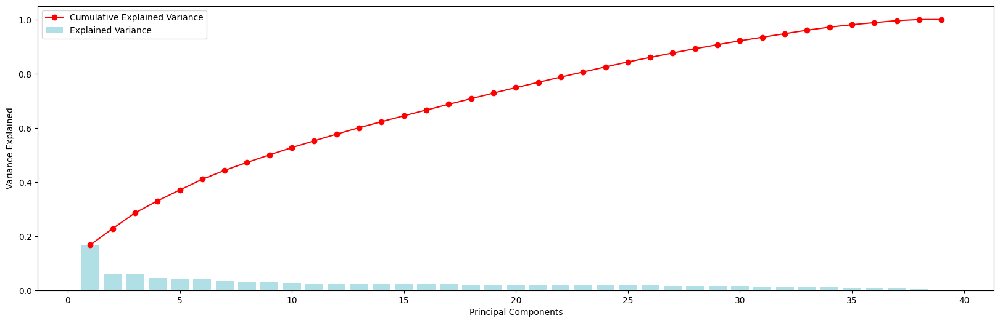

In [7]:
from sklearn.decomposition import PCA

pca = PCA()
principal_components = pca.fit_transform(correlations_per_responder['responder_6'])

plt.figure(figsize=(20, 6))
plt.bar(range(1, 40), pca.explained_variance_ratio_, align='center', label='Explained Variance', color='powderblue')
plt.plot(range(1, 40), np.cumsum(pca.explained_variance_ratio_), 'o-', label='Cumulative Explained Variance', color='r')

plt.xlabel('Principal Components')
plt.ylabel('Variance Explained')
plt.legend()

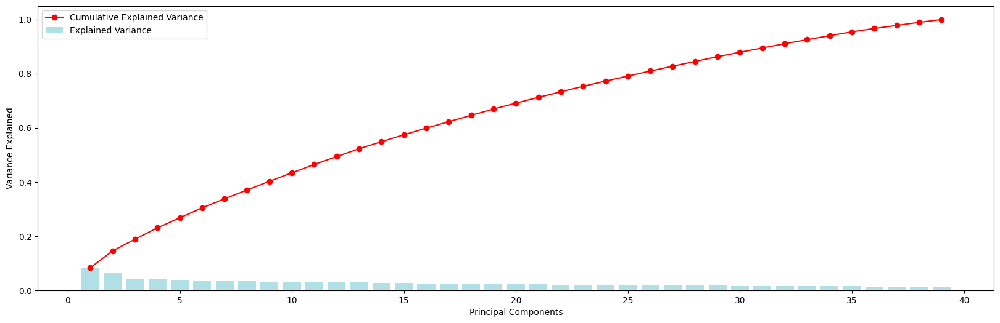

In [8]:
columns = [f'responder_6_{i}' for i in range(39)]

pca = PCA()
principal_components = pca.fit_transform(responders_pivot[columns].to_pandas())

plt.figure(figsize=(20, 6))
plt.bar(range(1, 40), pca.explained_variance_ratio_, align='center', label='Explained Variance', color='powderblue')
plt.plot(range(1, 40), np.cumsum(pca.explained_variance_ratio_), 'o-', label='Cumulative Explained Variance', color='r')

plt.xlabel('Principal Components')
plt.ylabel('Variance Explained')
plt.legend()

In [9]:
responders_pivot.head()

date_id,time_id,responder_0_1,responder_0_7,responder_0_9,responder_0_10,responder_0_14,responder_0_16,responder_0_19,responder_0_33,responder_0_0,responder_0_2,responder_0_13,responder_0_15,responder_0_38,responder_0_3,responder_0_12,responder_0_8,responder_0_17,responder_0_34,responder_0_11,responder_0_30,responder_0_5,responder_0_20,responder_0_21,responder_0_22,responder_0_25,responder_0_26,responder_0_29,responder_0_36,responder_0_23,responder_0_27,responder_0_28,responder_0_35,responder_0_37,responder_0_4,responder_0_24,…,responder_8_9,responder_8_10,responder_8_14,responder_8_16,responder_8_19,responder_8_33,responder_8_0,responder_8_2,responder_8_13,responder_8_15,responder_8_38,responder_8_3,responder_8_12,responder_8_8,responder_8_17,responder_8_34,responder_8_11,responder_8_30,responder_8_5,responder_8_20,responder_8_21,responder_8_22,responder_8_25,responder_8_26,responder_8_29,responder_8_36,responder_8_23,responder_8_27,responder_8_28,responder_8_35,responder_8_37,responder_8_4,responder_8_24,responder_8_31,responder_8_6,responder_8_18,responder_8_32
i16,i16,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,…,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32
0,0,0.738489,2.965889,-0.864488,0.408499,-0.373387,0.505199,0.096462,0.209253,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,0.772828,-1.379516,-5.0,-0.101013,0.184303,0.280629,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,1,0.80866,3.119074,-0.962893,0.249527,-0.225428,-0.499438,0.052181,0.214374,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,0.898612,3.902426,-4.121665,0.263108,0.039609,0.181041,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,2,1.008327,4.780859,-0.891955,-1.273521,-0.217807,0.953355,0.063074,0.182786,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,0.723078,0.799255,-5.0,0.339472,0.311067,0.53101,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,3,0.848002,4.239198,-0.644806,-0.991729,-0.307403,1.078218,0.036324,0.259406,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,1.342801,-0.281881,-4.052035,0.305233,0.571973,0.295483,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,4,1.151784,4.538052,3.144852,-5.0,0.965314,-4.234819,-4.571598,-1.402216,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,…,0.37334,0.119153,-3.656975,-0.313954,0.241637,-0.288988,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


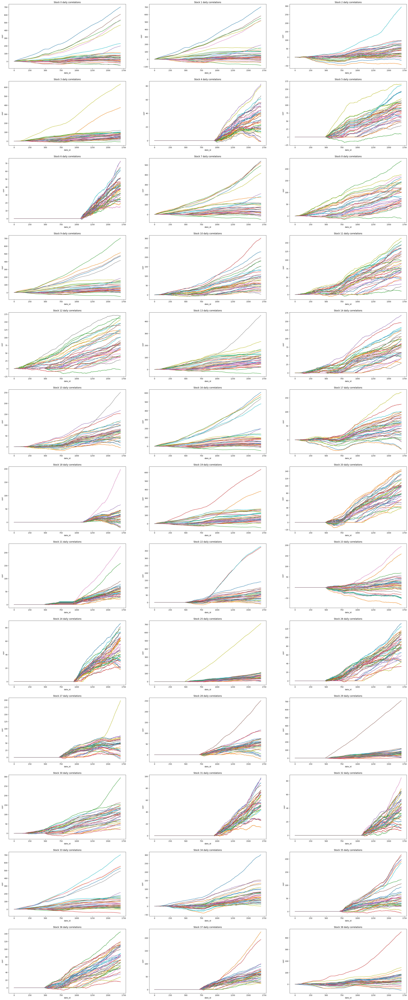

In [10]:
fig, axes = plt.subplots(13, 3, figsize=(40, 100))
axes = axes.flatten()

for i in range(39):
    stock_i_correlations = responders_pivot.group_by('date_id').agg(
        pl.corr(f'responder_6_{j}', f'responder_6_{i}').alias(f'stock_{j}_corr') for j in range(39)
    ).fill_null(0).fill_nan(0).drop(f'stock_{i}_corr').sort('date_id')

    for j in range(39):
        if j != i:
            axes[i].plot(stock_i_correlations[f'stock_{j}_corr'].to_numpy().cumsum())
    axes[i].set_xlabel('date_id')
    axes[i].set_ylabel('corr')
    axes[i].set_title(f'Stock {i} daily correlations')

plt.show()

In [11]:
responders_pivot_lag = responders_pivot.with_columns(
    [pl.col(f'responder_6_{i}').alias(f'responder_6_{i}_daily_lag') for i in range(39)] + \
    [pl.col('date_id').add(1)]
).select(['date_id', 'time_id'] + [f'responder_6_{i}_daily_lag' for i in range(39)])
responders_pivot_lag = responders_pivot.select([f'responder_6_{i}' for i in range(39)] + ['date_id', 'time_id']) \
    .join(responders_pivot_lag, on=['date_id', 'time_id'])

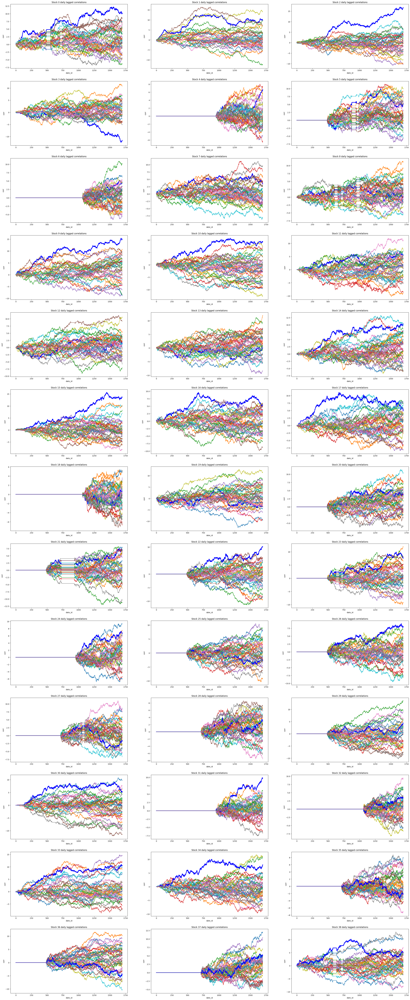

In [12]:
fig, axes = plt.subplots(13, 3, figsize=(40, 100))
axes = axes.flatten()

for i in range(39):
    stock_i_correlations = responders_pivot_lag.group_by('date_id').agg(
        pl.corr(f'responder_6_{j}_daily_lag', f'responder_6_{i}').alias(f'stock_{j}_corr') for j in range(39)
    ).fill_null(0).fill_nan(0).sort('date_id')
    
    for j in range(39):
        if j != i:
            axes[i].plot(stock_i_correlations[f'stock_{j}_corr'].to_numpy().cumsum())
        else:
            axes[i].plot(stock_i_correlations[f'stock_{j}_corr'].to_numpy().cumsum(), linewidth=3, color='blue')
    axes[i].set_xlabel('date_id')
    axes[i].set_ylabel('corr')
    axes[i].set_title(f'Stock {i} daily lagged correlations')

plt.show()